In [1]:
import torch
from vision.datasets.open_images import OpenImagesDataset
from vision.utils import box_utils, measurements
from vision.utils.misc import str2bool, Timer
import pathlib
import numpy as np
import logging
import sys
from PIL import Image, ImageFilter
from vision.ssd.mobilenet_v2_ssd_lite import create_mobilenetv2_ssd_lite_predictor
from vision.ssd.mobilenetv3_ssd_lite import create_mobilenetv3_small_ssd_lite, create_mobilenetv3_large_ssd_lite
from vision.ssd.mobilenet_v2_ssd_lite import create_mobilenetv2_ssd_lite
import time
import cv2
import pandas as pd
import glob
import os

DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [2]:
trained_model = "./models/gaku_cornv18_large_exPseudocan/mbv3-Epoch-105-Loss-1.7624352441893683.pth" #モデルパス
nms_method = "hard"
iou_threshold = 0.5 #"The threshold of Intersection over Union."
use_2007_metric = True
#eval_dir = "eval_results" #The directory to store evaluation results
label_file = "./models/gaku_cornv18_large_exPseudocan/open-images-model-labels.txt" #The label file path
class_names = [name.strip() for name in open(label_file).readlines()]

In [3]:
#net = create_mobilenetv3_small_ssd_lite(len(class_names), is_test=True)
#net = create_mobilenetv2_ssd_lite(len(class_names), is_test=True)
net = create_mobilenetv3_large_ssd_lite(len(class_names), is_test=True)
net.load(trained_model)
net = net.to(DEVICE)
predictor = create_mobilenetv2_ssd_lite_predictor(net, nms_method=nms_method, device=DEVICE)

In [4]:
d1 = "./arliss_test/hikage_*_can.JPG"
d2 = "./arliss_test/hikage_*_cone.JPG"
d3 = "./arliss_test/hikage_*_conecan.JPG"
d4 = "./arliss_test/hinata_*_can.JPG"
d5 = "./arliss_test/hinata_*_cone.JPG"
d6 = "./arliss_test/hinata_*_conecan.JPG"
d7 = "./dawn_images/*"
dx = [d2]
outdir = "./arliss_test_out/"
list1 = []
for i in dx:
    new = np.unique(glob.glob(i))
    list1.extend(new)
img_paths = list1

In [5]:
print(img_paths)

['./arliss_test/hikage_000_cone.JPG', './arliss_test/hikage_030_cone.JPG', './arliss_test/hikage_060_cone.JPG', './arliss_test/hikage_090_cone.JPG', './arliss_test/hikage_120_cone.JPG', './arliss_test/hikage_150_cone.JPG', './arliss_test/hikage_180_cone.JPG', './arliss_test/hikage_210_cone.JPG', './arliss_test/hikage_240_cone.JPG', './arliss_test/hikage_270_cone.JPG', './arliss_test/hikage_300_cone.JPG', './arliss_test/hikage_330_cone.JPG', './arliss_test/hikage_360_cone.JPG', './arliss_test/hikage_390_cone.JPG', './arliss_test/hikage_420_cone.JPG', './arliss_test/hikage_450_cone.JPG', './arliss_test/hikage_480_cone.JPG', './arliss_test/hikage_500_cone.JPG', './arliss_test/hikage_510_cone.JPG', './arliss_test/hikage_520_cone.JPG', './arliss_test/hikage_540_cone.JPG', './arliss_test/hikage_570_cone.JPG', './arliss_test/hikage_600_cone.JPG', './arliss_test/hikage_630_cone.JPG', './arliss_test/hikage_660_cone.JPG', './arliss_test/hikage_690_cone.JPG']


In [6]:
def zero_pad_infer(image, box):
    target = image[box[1]:box[3], box[0]:box[2]]
    h, w, _ = target.shape
    if(h == 0 or w == 0):
        return
    r = min(300 / h, 300 / w)
    target = cv2.resize(target, (int(w * r) - (int(w * r) % 2), int(h * r) - (int(h * r) % 2)))
    black_img = np.zeros((300, 300, 3), dtype = np.uint8)
    print(black_img.shape, target.shape)
    x_range = int(w * r) // 2
    y_range = int(h * r) // 2
    black_img[150-y_range:150+y_range, 150-x_range:150+x_range] = target
    infer(black_img, check = False)

def infer(image, check = True):
    image = cv2.resize(image, (300, 300))
    boxes, labels, probs = predictor.predict(image, 10, 0.4)
    
    for i in range(len(boxes)):
        box = boxes[i, :]
        box = list(map(int, box))
        #if (check == True) and (not zero_pad_infer(image, box)):
        #    continue
        flag = 1
        label = class_names[labels[i]] + str(probs[i])
        cv2.rectangle(image, (box[0], box[1]), (box[2], box[3]), (255, 255, 0), 4)
        print(label)
        cv2.putText(image, label,
                    (int(box[0]) + 20, int(box[1]) + 40),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.3,  # font scale
                    (255, 0, 255),
                    1)  # line type
    display(Image.fromarray(image))

./arliss_test/hikage_000_cone.JPG
Inference time:  0.3134160041809082
cantensor(0.7532, device='cuda:0')
trafficconetensor(0.8592, device='cuda:0')


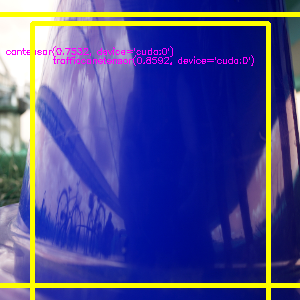

Inference time:  0.011063814163208008
cantensor(0.6556, device='cuda:0')
trafficconetensor(0.9289, device='cuda:0')


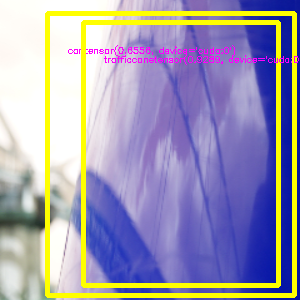

Inference time:  0.06290102005004883
cantensor(0.8070, device='cuda:0')
trafficconetensor(0.6923, device='cuda:0')


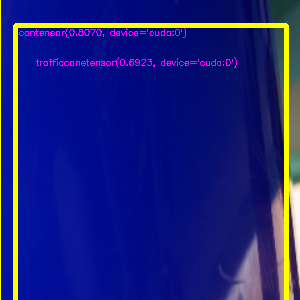

Inference time:  0.011131763458251953
cantensor(0.7715, device='cuda:0')
trafficconetensor(0.7456, device='cuda:0')


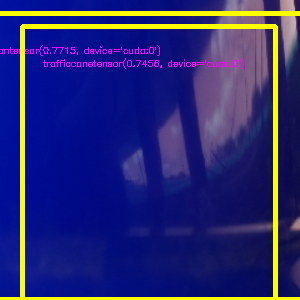

Inference time:  0.010793685913085938
cantensor(0.6084, device='cuda:0')
trafficconetensor(0.9293, device='cuda:0')


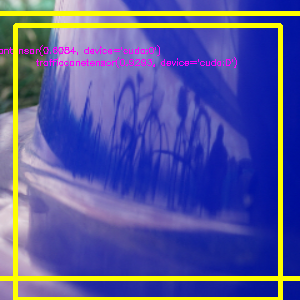

./arliss_test/hikage_030_cone.JPG
Inference time:  0.010695219039916992
trafficconetensor(0.9849, device='cuda:0')


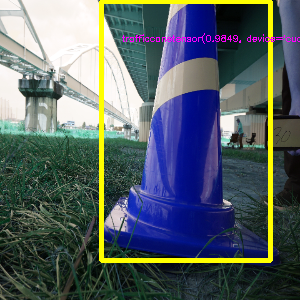

Inference time:  0.010906219482421875


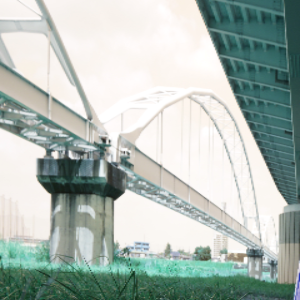

Inference time:  0.018990039825439453
trafficconetensor(0.9577, device='cuda:0')


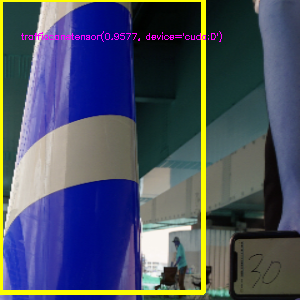

Inference time:  0.01072072982788086
cantensor(0.4311, device='cuda:0')
trafficconetensor(0.7539, device='cuda:0')


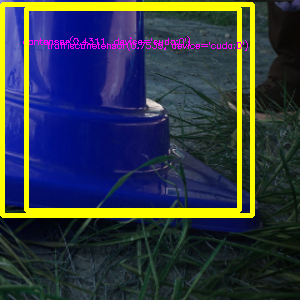

Inference time:  0.01070261001586914
trafficconetensor(0.8552, device='cuda:0')


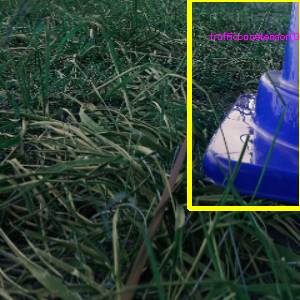

./arliss_test/hikage_060_cone.JPG
Inference time:  0.01069951057434082
trafficconetensor(0.8866, device='cuda:0')


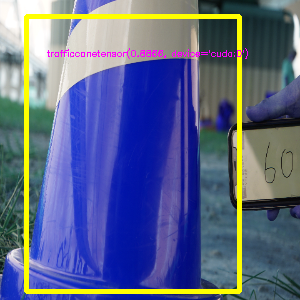

Inference time:  0.01125025749206543
trafficconetensor(0.9124, device='cuda:0')


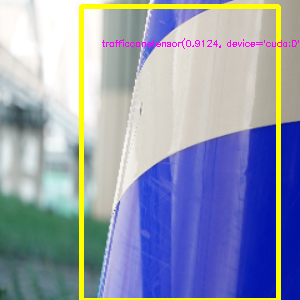

Inference time:  0.011017799377441406
trafficconetensor(0.7633, device='cuda:0')


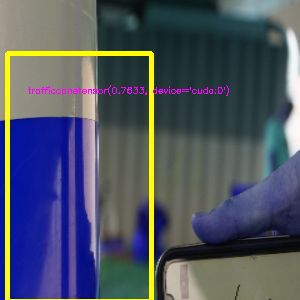

Inference time:  0.011084794998168945
trafficconetensor(0.8298, device='cuda:0')


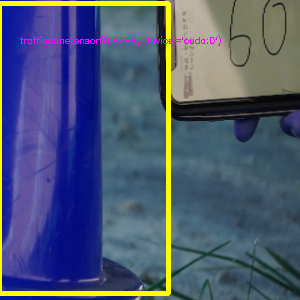

Inference time:  0.04506087303161621
cantensor(0.7611, device='cuda:0')
trafficconetensor(0.7392, device='cuda:0')


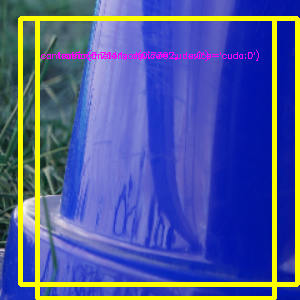

./arliss_test/hikage_090_cone.JPG
Inference time:  0.010747671127319336
trafficconetensor(0.9919, device='cuda:0')


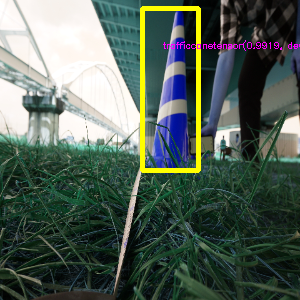

Inference time:  0.010642528533935547


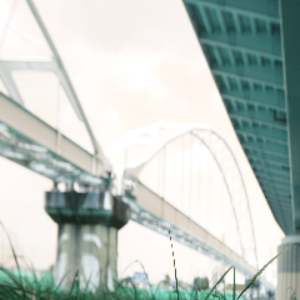

Inference time:  0.010730743408203125
trafficconetensor(0.9520, device='cuda:0')


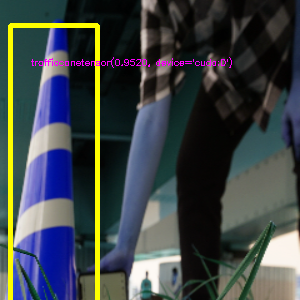

Inference time:  0.010654926300048828


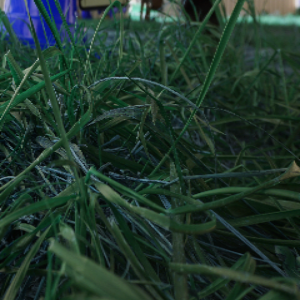

Inference time:  0.010708093643188477
cantensor(0.4575, device='cuda:0')


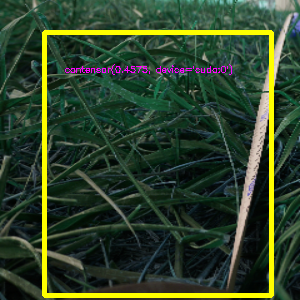

./arliss_test/hikage_120_cone.JPG
Inference time:  0.010735750198364258
trafficconetensor(0.9324, device='cuda:0')


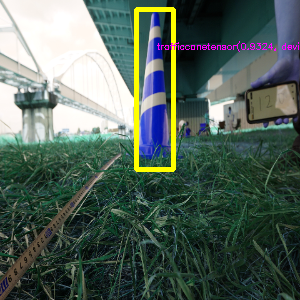

Inference time:  0.011468172073364258


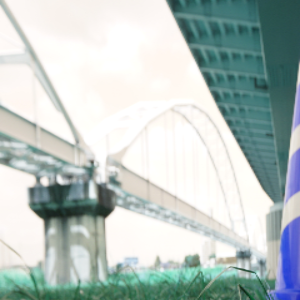

Inference time:  0.01107168197631836
trafficconetensor(0.4202, device='cuda:0')


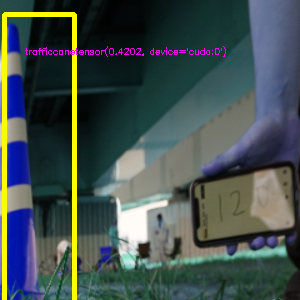

Inference time:  0.010657072067260742


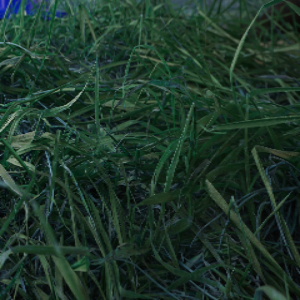

Inference time:  0.010610103607177734


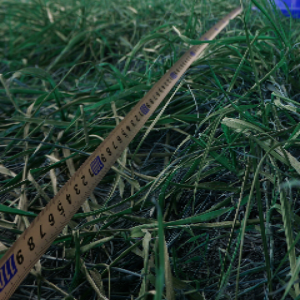

./arliss_test/hikage_150_cone.JPG
Inference time:  0.010914087295532227
trafficconetensor(0.9962, device='cuda:0')


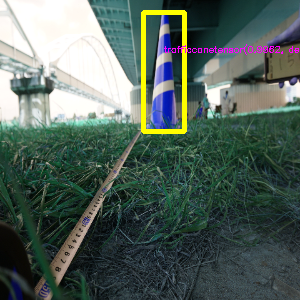

Inference time:  0.010705947875976562


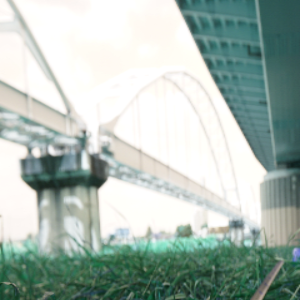

Inference time:  0.01063227653503418
trafficconetensor(0.9614, device='cuda:0')


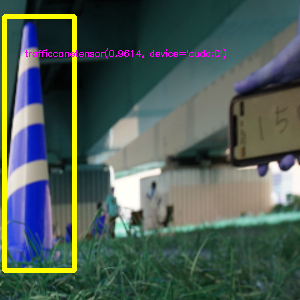

Inference time:  0.01138162612915039


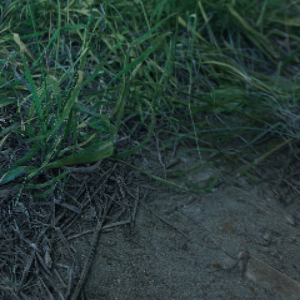

Inference time:  0.030922412872314453


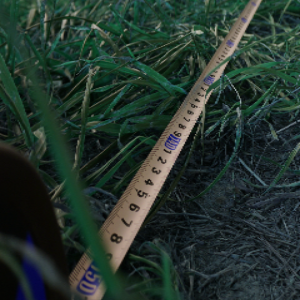

./arliss_test/hikage_180_cone.JPG
Inference time:  0.04767155647277832
trafficconetensor(0.9969, device='cuda:0')


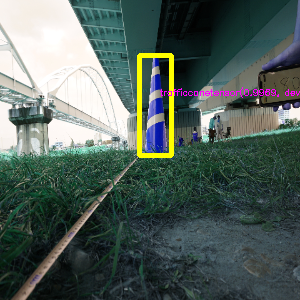

Inference time:  0.010549545288085938


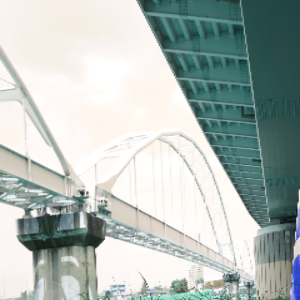

Inference time:  0.010536432266235352
trafficconetensor(0.8418, device='cuda:0')


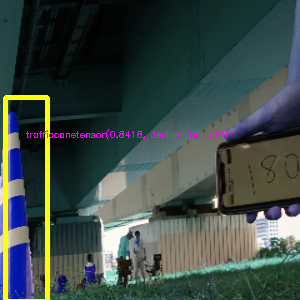

Inference time:  0.010546445846557617


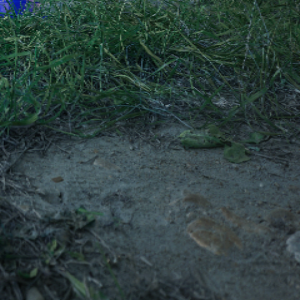

Inference time:  0.010584354400634766
cantensor(0.9650, device='cuda:0')


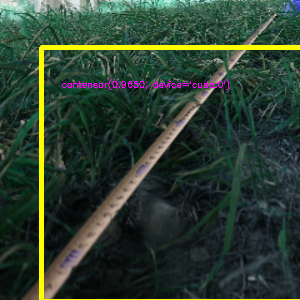

./arliss_test/hikage_210_cone.JPG
Inference time:  0.010499238967895508
trafficconetensor(0.9746, device='cuda:0')


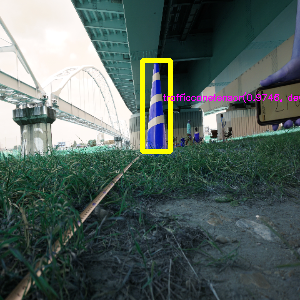

Inference time:  0.01074361801147461


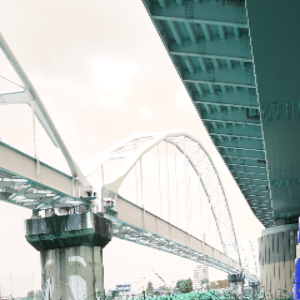

Inference time:  0.022542953491210938
trafficconetensor(0.8405, device='cuda:0')


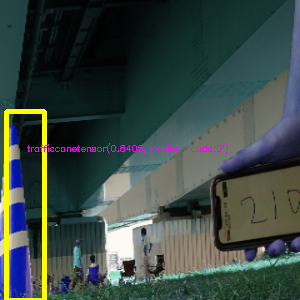

Inference time:  0.01069331169128418


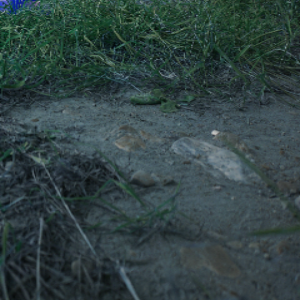

Inference time:  0.010598897933959961
cantensor(0.6418, device='cuda:0')


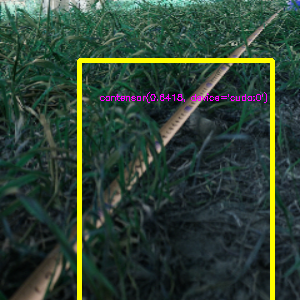

./arliss_test/hikage_240_cone.JPG
Inference time:  0.010479927062988281
trafficconetensor(0.8385, device='cuda:0')


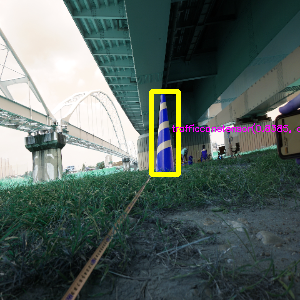

Inference time:  0.010635852813720703


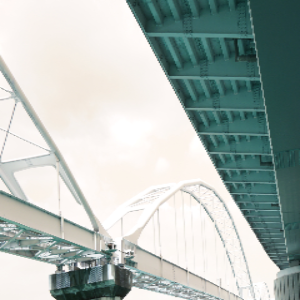

Inference time:  0.010718345642089844
trafficconetensor(0.9784, device='cuda:0')


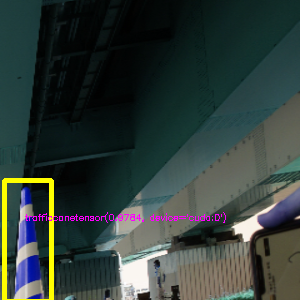

Inference time:  0.010597705841064453
trafficconetensor(0.7632, device='cuda:0')


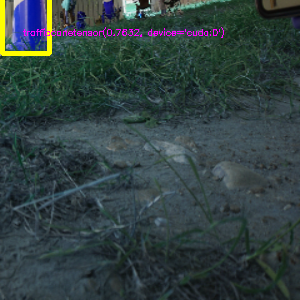

Inference time:  0.010932445526123047


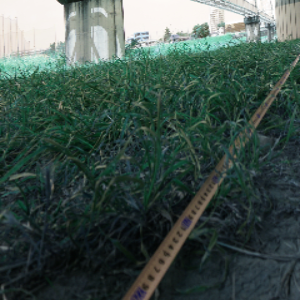

./arliss_test/hikage_270_cone.JPG
Inference time:  0.010361194610595703
trafficconetensor(0.4394, device='cuda:0')


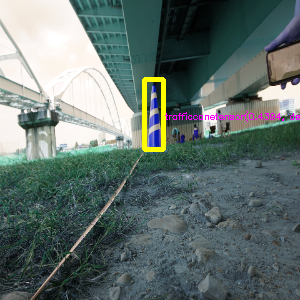

Inference time:  0.03148913383483887


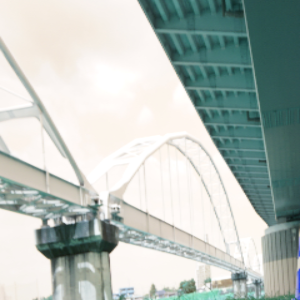

Inference time:  0.010570049285888672
trafficconetensor(0.5754, device='cuda:0')


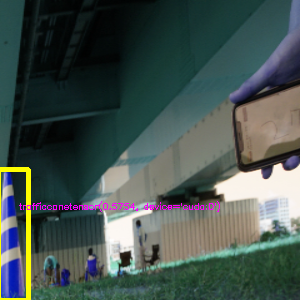

Inference time:  0.010520219802856445


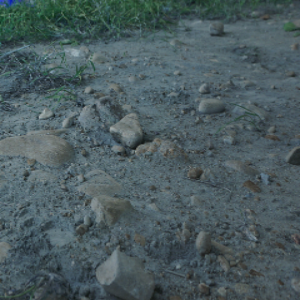

Inference time:  0.010629415512084961


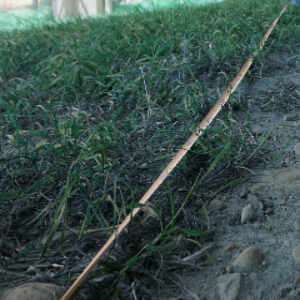

./arliss_test/hikage_300_cone.JPG
Inference time:  0.010675191879272461


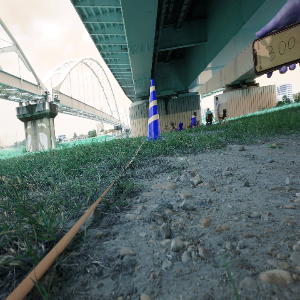

Inference time:  0.010649442672729492


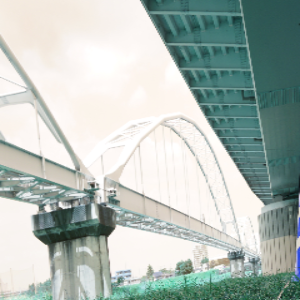

Inference time:  0.01056361198425293
trafficconetensor(0.7290, device='cuda:0')


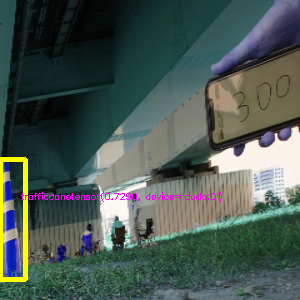

Inference time:  0.010544300079345703


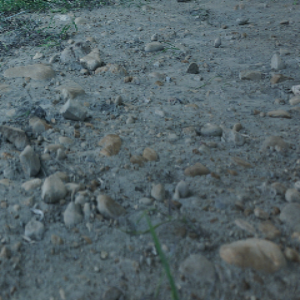

Inference time:  0.011199951171875


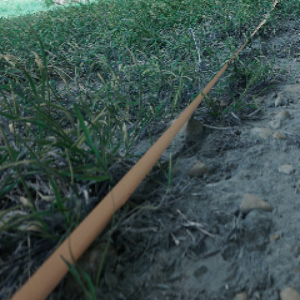

./arliss_test/hikage_330_cone.JPG
Inference time:  0.010414600372314453


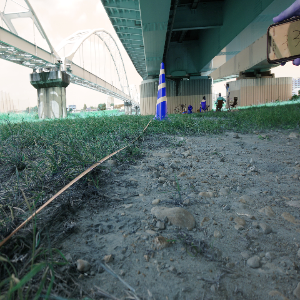

Inference time:  0.010596752166748047


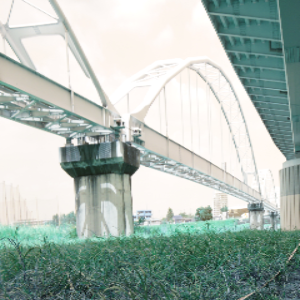

Inference time:  0.04574394226074219
trafficconetensor(0.9959, device='cuda:0')


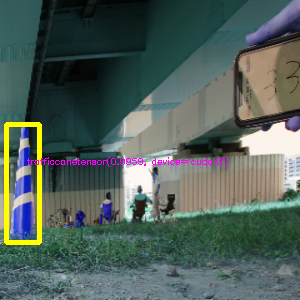

Inference time:  0.01056361198425293


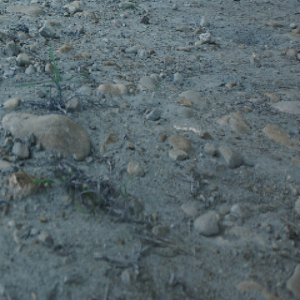

Inference time:  0.010081768035888672


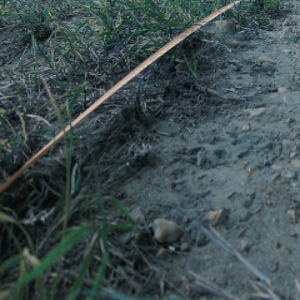

./arliss_test/hikage_360_cone.JPG
Inference time:  0.010631799697875977


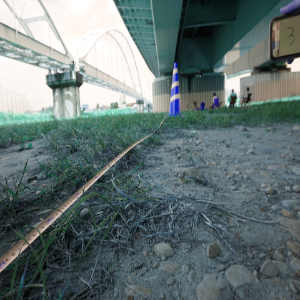

Inference time:  0.010540485382080078


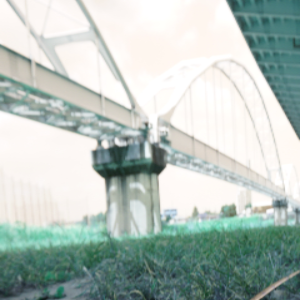

Inference time:  0.010542154312133789
trafficconetensor(0.9637, device='cuda:0')


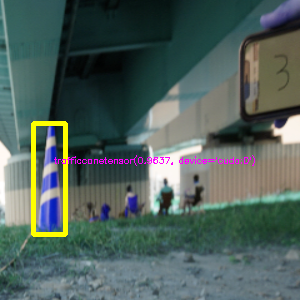

Inference time:  0.010649681091308594


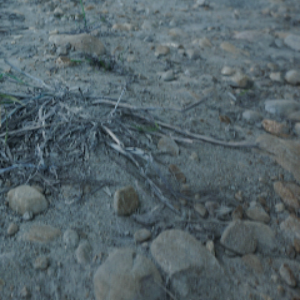

Inference time:  0.010913372039794922


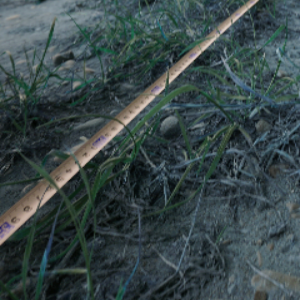

./arliss_test/hikage_390_cone.JPG
Inference time:  0.010239124298095703


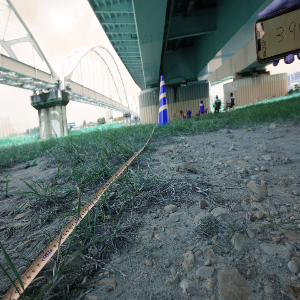

Inference time:  0.011222124099731445


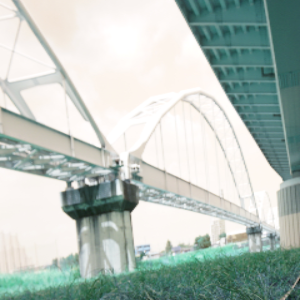

Inference time:  0.010770320892333984
trafficconetensor(0.9965, device='cuda:0')


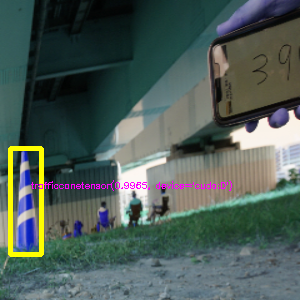

Inference time:  0.010249614715576172


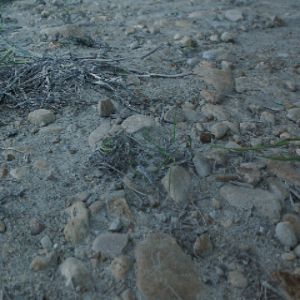

Inference time:  0.010197162628173828


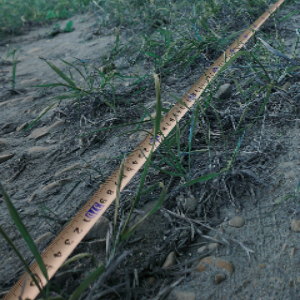

./arliss_test/hikage_420_cone.JPG
Inference time:  0.010251998901367188


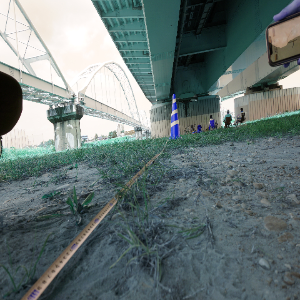

Inference time:  0.010153532028198242


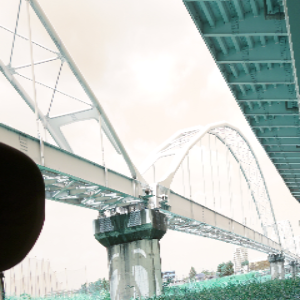

Inference time:  0.010187149047851562
trafficconetensor(0.9486, device='cuda:0')


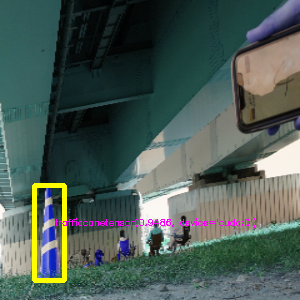

Inference time:  0.010447502136230469


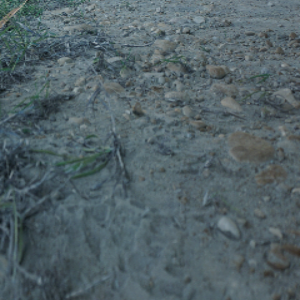

Inference time:  0.010553121566772461


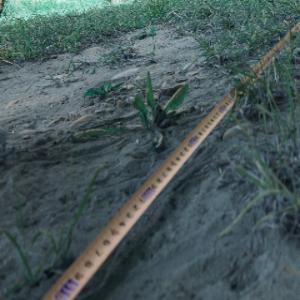

./arliss_test/hikage_450_cone.JPG
Inference time:  0.010269641876220703


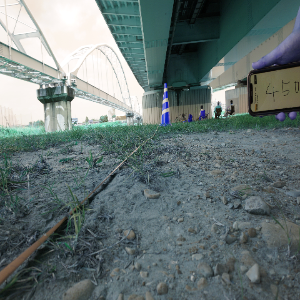

Inference time:  0.010653972625732422


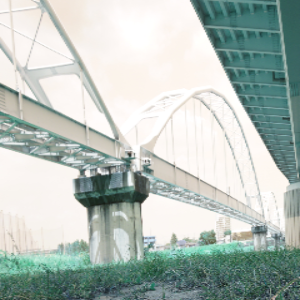

Inference time:  0.010522127151489258
trafficconetensor(0.8075, device='cuda:0')


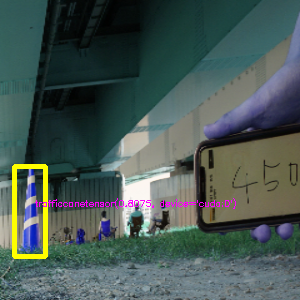

Inference time:  0.010284423828125


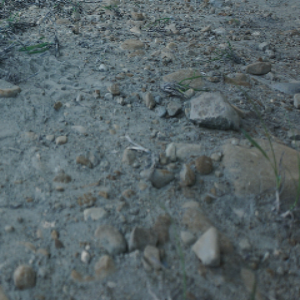

Inference time:  0.010392427444458008


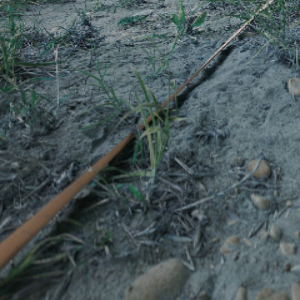

./arliss_test/hikage_480_cone.JPG
Inference time:  0.010500669479370117


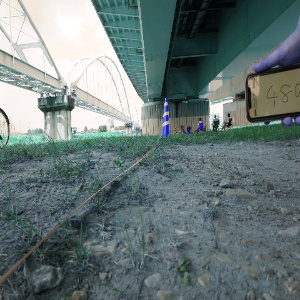

Inference time:  0.010635137557983398


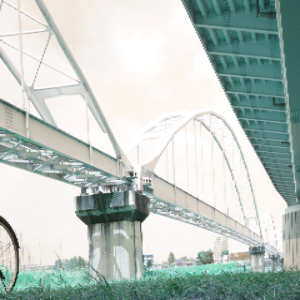

Inference time:  0.010159730911254883
trafficconetensor(0.6150, device='cuda:0')


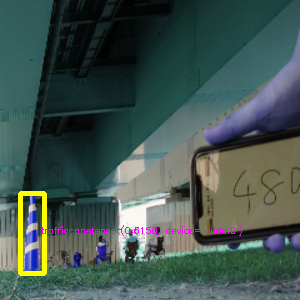

Inference time:  0.010538816452026367


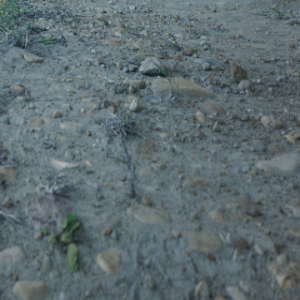

Inference time:  0.045943498611450195


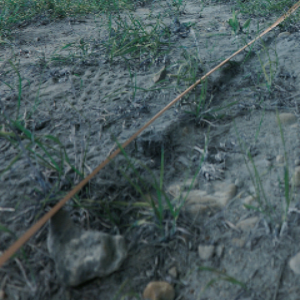

./arliss_test/hikage_500_cone.JPG
Inference time:  0.010509729385375977


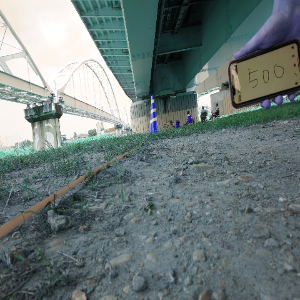

Inference time:  0.010783672332763672


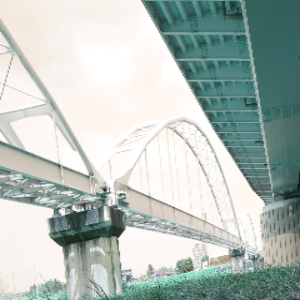

Inference time:  0.02263331413269043
trafficconetensor(0.4345, device='cuda:0')


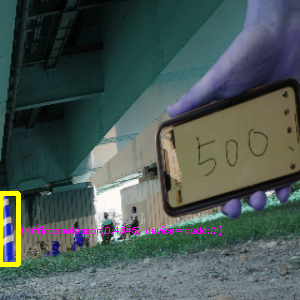

Inference time:  0.010583639144897461


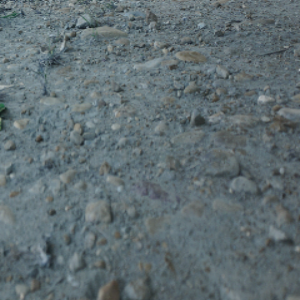

Inference time:  0.010482549667358398


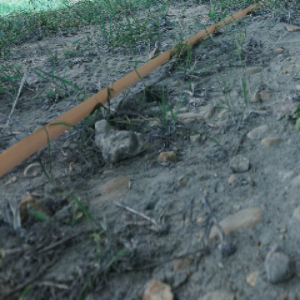

./arliss_test/hikage_510_cone.JPG
Inference time:  0.01070713996887207


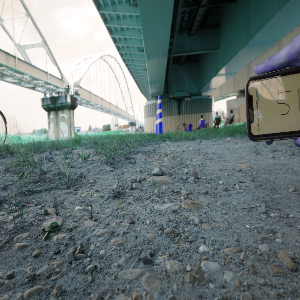

Inference time:  0.010543346405029297


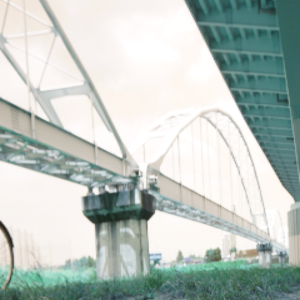

Inference time:  0.01055002212524414
trafficconetensor(0.9042, device='cuda:0')
trafficconetensor(0.4530, device='cuda:0')


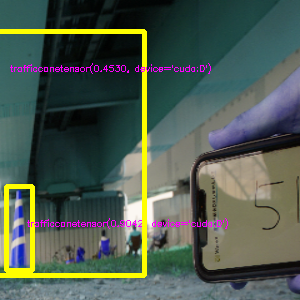

Inference time:  0.010529518127441406


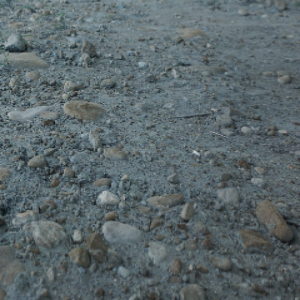

Inference time:  0.010576963424682617


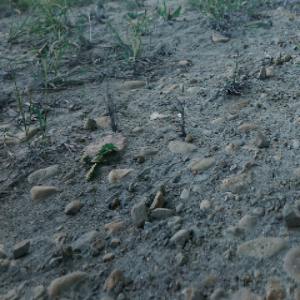

./arliss_test/hikage_520_cone.JPG
Inference time:  0.010642766952514648


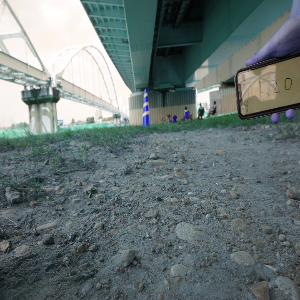

Inference time:  0.01048898696899414
trafficconetensor(0.4828, device='cuda:0')


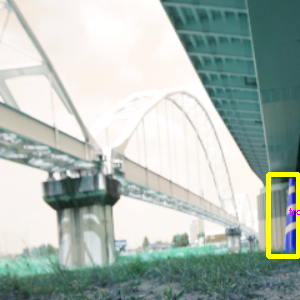

Inference time:  0.011111259460449219


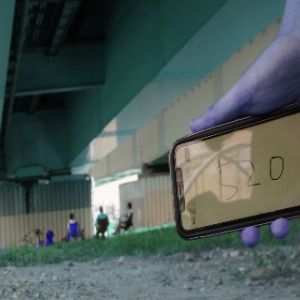

Inference time:  0.010795831680297852


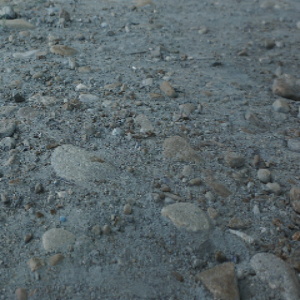

Inference time:  0.010479450225830078


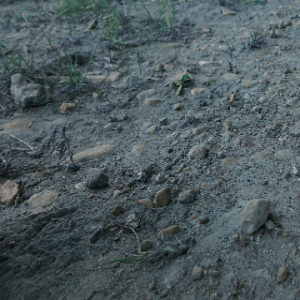

./arliss_test/hikage_540_cone.JPG
Inference time:  0.010596513748168945


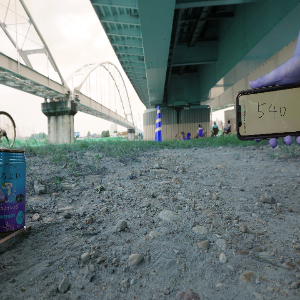

Inference time:  0.011123895645141602


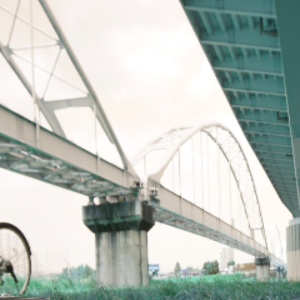

Inference time:  0.010437250137329102
trafficconetensor(0.7402, device='cuda:0')


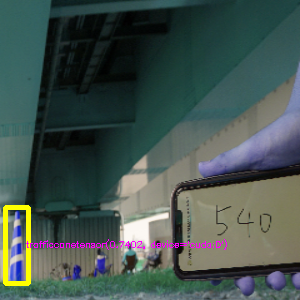

Inference time:  0.010452985763549805


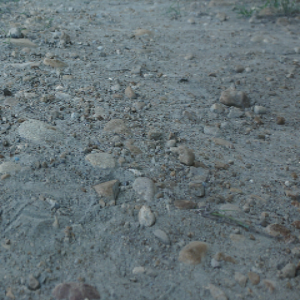

Inference time:  0.010469913482666016
cantensor(0.8236, device='cuda:0')


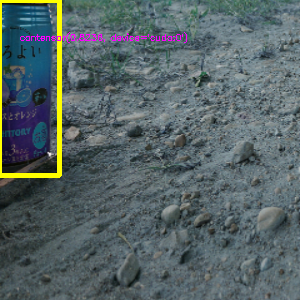

./arliss_test/hikage_570_cone.JPG
Inference time:  0.01043558120727539


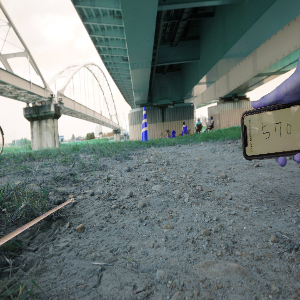

Inference time:  0.010506868362426758
trafficconetensor(0.7059, device='cuda:0')


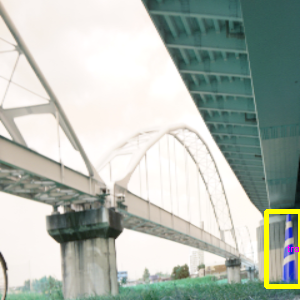

Inference time:  0.01053166389465332


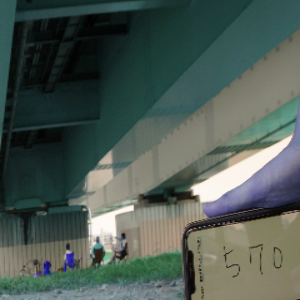

Inference time:  0.010630607604980469


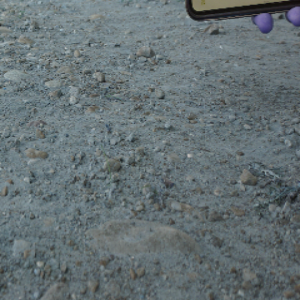

Inference time:  0.010436534881591797


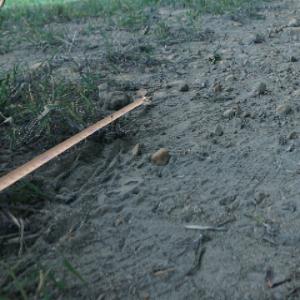

./arliss_test/hikage_600_cone.JPG
Inference time:  0.010483741760253906


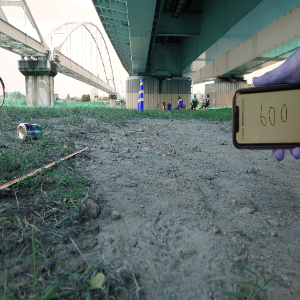

Inference time:  0.01050424575805664
trafficconetensor(0.6057, device='cuda:0')


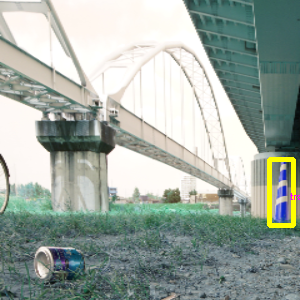

Inference time:  0.010541200637817383


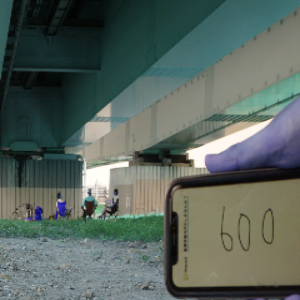

Inference time:  0.010457754135131836


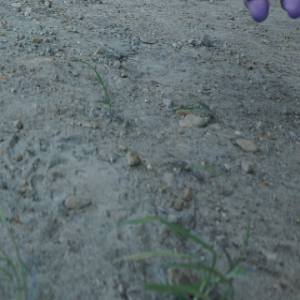

Inference time:  0.010736227035522461


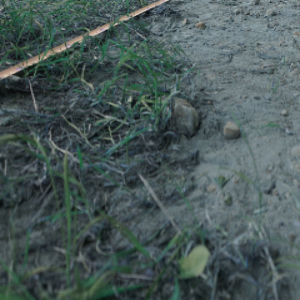

./arliss_test/hikage_630_cone.JPG
Inference time:  0.010240793228149414


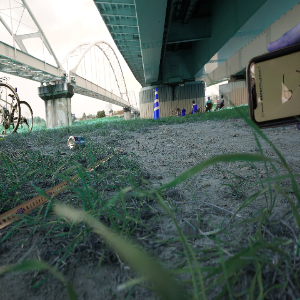

Inference time:  0.034223079681396484


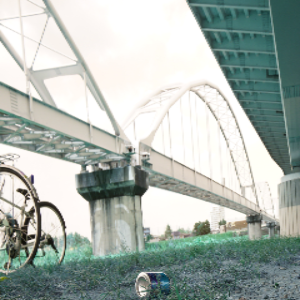

Inference time:  0.010451793670654297
trafficconetensor(0.4654, device='cuda:0')


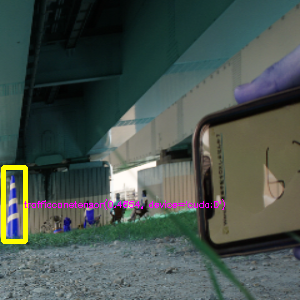

Inference time:  0.010315895080566406


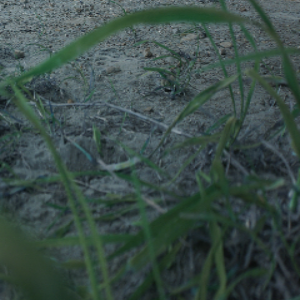

Inference time:  0.01008915901184082


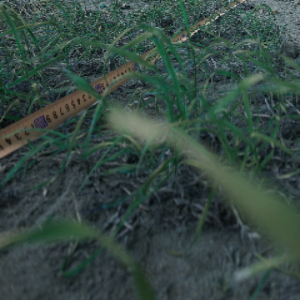

./arliss_test/hikage_660_cone.JPG
Inference time:  0.010188102722167969


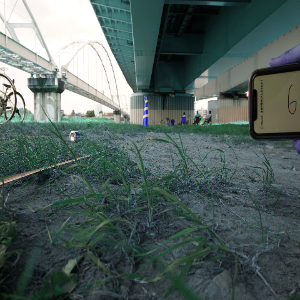

Inference time:  0.010530710220336914


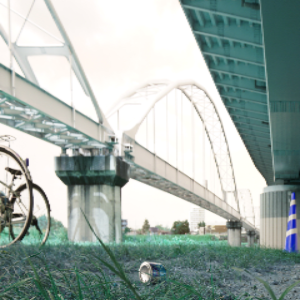

Inference time:  0.010431051254272461


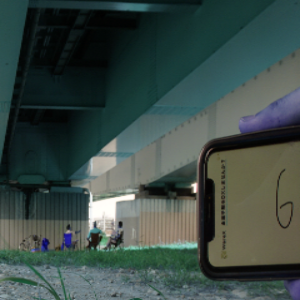

Inference time:  0.010228633880615234


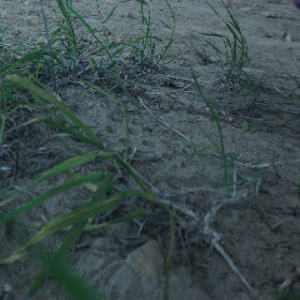

Inference time:  0.010128021240234375


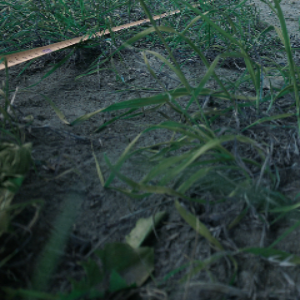

./arliss_test/hikage_690_cone.JPG
Inference time:  0.010084867477416992


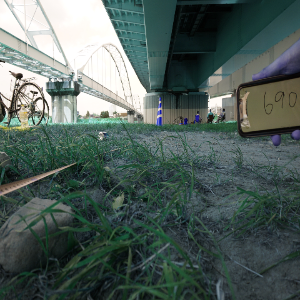

Inference time:  0.010477542877197266


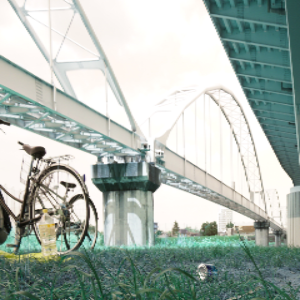

Inference time:  0.033055782318115234


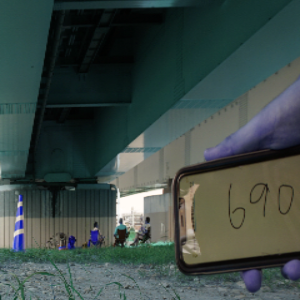

Inference time:  0.010258913040161133


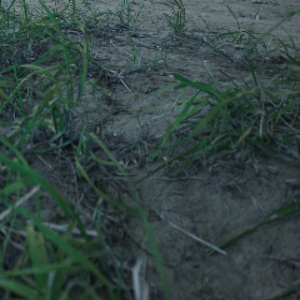

Inference time:  0.010138750076293945


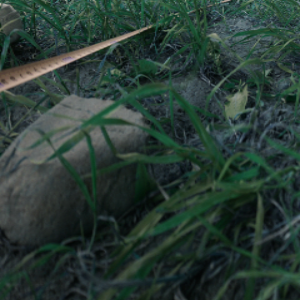

In [7]:
for img_path in img_paths:
    print(img_path)
    image = cv2.imread(img_path)
    image = cv2.resize(image, (480, 640))
    h, w, _ = image.shape
    img_l_u = image[:h//2, :w//2]
    img_r_u = image[:h//2, w//2:]
    img_l_b = image[h//2:, w//2:]
    img_r_b = image[h//2:, :w//2]
    for img in [image, img_l_u, img_r_u, img_l_b, img_r_b]:
        infer(img)
    #cv2.imwrite(out_path, image)